In [1]:
# import ../.env
import os
from dotenv import load_dotenv
import json
load_dotenv()
# delete rag_results and chroma dbs
import shutil
from tqdm.notebook import tqdm

shutil.rmtree("./rag_results", ignore_errors=True)
shutil.rmtree("./chromadb", ignore_errors=True)


In [2]:
# !jupyter nbextension enable --py widgetsnbextension --sys-prefix

In [ ]:
from text_to_sql_rag.rag_graph import RAGWorkflow
from text_to_sql_rag.rag_db import RAGDatabase
from langchain_openai import ChatOpenAI

llm = ChatOpenAI(
    model_name="openai/gpt-4.1-mini",
    openai_api_key="your-openai-api-key-here",
    base_url="https://openrouter.ai/api/v1",
    temperature=0.0
)
# Initialize database with distance function
db = RAGDatabase(
    embedding_model="text-embedding-3-small",
    chroma_persist_directory="./chromadb",
    distance_function="cosine"
)
        
workflow = RAGWorkflow(llm, db, distance_function='cosine')

In [4]:
# Import our separated components
from text_to_sql_rag.rag_db import known_embedders
from text_to_sql_rag.rag import RAGSystem

In [5]:
example_rag = RAGSystem(
    k=10,
    skip_generation=False,
    workflow=workflow
)

In [6]:
example_rag.query("What is the capital of France?")


🚀 Starting RAG query: What is the capital of France?
🔍 Processing query: What is the capital of France?
📚 Retrieving top 10 documents for query: What is the capital of France?
✅ Retrieved 0 documents
🤖 Generating answer using retrieved context...
✅ Generated answer: The provided context does not contain information about the capital of France. However, I can tell you that the capital of France is Paris....


{'query': 'What is the capital of France?',
 'answer': 'The provided context does not contain information about the capital of France. However, I can tell you that the capital of France is Paris.',
 'retrieved_documents': [],
 'context': '',
 'messages': [HumanMessage(content='What is the capital of France?', additional_kwargs={}, response_metadata={}, id='be208d62-a520-4332-a67b-737e923cf6bc'),
  AIMessage(content='The provided context does not contain information about the capital of France. However, I can tell you that the capital of France is Paris.', additional_kwargs={}, response_metadata={}, id='70374dd2-f02f-4b00-b9d2-c3397803a83c')],
 'timestamp': '2025-06-02T19:56:52.050451',
 'model_name': 'openai/gpt-4.1-nano',
 'embedding_model': 'text-embedding-3-small',
 'k': 10}

In [7]:
"""Example usage of the RAG system with CSV export"""
print("🔧 Initializing RAG System...")
k = 10

rag_systems = {}
embedding_models = list(known_embedders.keys())
print(embedding_models)
# Create chroma dbs directory if it doesn't exist
os.makedirs("./chromadb", exist_ok=True)


for embedding_model in embedding_models:
    # Initialize RAG system with OpenRouter
    db = RAGDatabase(
        embedding_model=embedding_model,
        chroma_persist_directory=f"./chromadb/chromadb_{embedding_model.replace('/', '_')}",
        distance_function="cosine"
    )
            
    workflow = RAGWorkflow(llm, db, distance_function='cosine')
    rag_systems[embedding_model] = RAGSystem(
        k=k,
        skip_generation=True,  # this is only testing the retrieval, not the generation,
        workflow=workflow
    )


# Check if we have documents
for embedding_model in rag_systems:
    rag = rag_systems[embedding_model]
    info = rag.get_collection_info()
    print(f"📊 Collection info: {info}")


🔧 Initializing RAG System...
['text-embedding-3-small', 'text-embedding-3-large', 'text-embedding-ada-002', 'embed-english-v3.0', 'embed-v4.0', 'sentence-transformers/all-MiniLM-L6-v2', 'jinaai/jina-embeddings-v3']
📊 Collection info: {'document_count': 0, 'collection_name': 'documents'}
📊 Collection info: {'document_count': 0, 'collection_name': 'documents'}
📊 Collection info: {'document_count': 0, 'collection_name': 'documents'}
📊 Collection info: {'document_count': 0, 'collection_name': 'documents'}
📊 Collection info: {'document_count': 0, 'collection_name': 'documents'}
📊 Collection info: {'document_count': 0, 'collection_name': 'documents'}
📊 Collection info: {'document_count': 0, 'collection_name': 'documents'}


In [8]:
with open('../dev.json', 'r') as f:
    dev_data = json.load(f)

queries = {dev_data['question']: [_.strip() for _ in dev_data['evidence'].split(';') if _.strip()] for dev_data in dev_data}
print(len(queries))
# only keep queries with evidence
queries = {k: v for k, v in queries.items() if len(v) > 0}
print(len(queries))


1533
1385


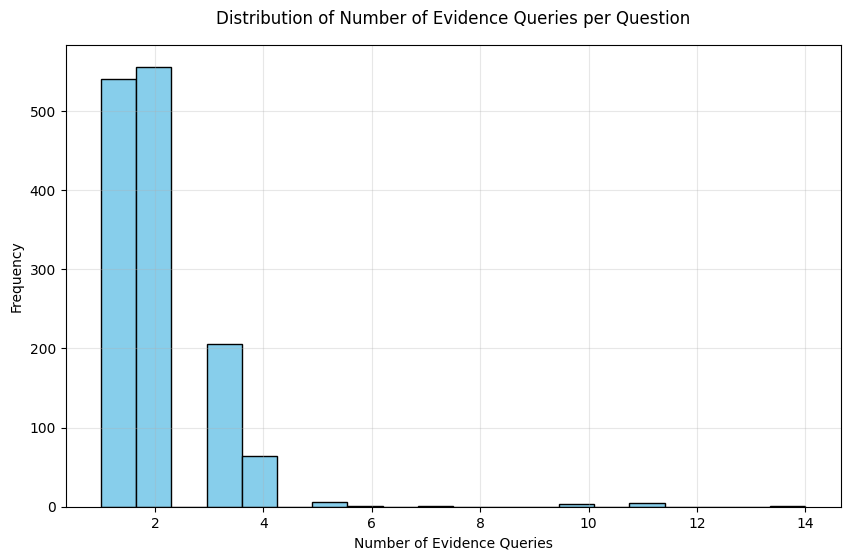

In [9]:
import pandas as pd
import matplotlib.pyplot as plt

query_df = pd.DataFrame(queries.items(), columns=['query', 'evidence'])

query_df['num_evidence_queries'] = query_df['evidence'].apply(lambda x: len(x))
query_df.sort_values(by='num_evidence_queries', ascending=False, inplace=True)
plt.figure(figsize=(10, 6))
query_df['num_evidence_queries'].hist(bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Number of Evidence Queries per Question', fontsize=12, pad=15)
plt.xlabel('Number of Evidence Queries', fontsize=10)
plt.ylabel('Frequency', fontsize=10)
plt.grid(True, alpha=0.3)
plt.show()


In [10]:
query_df[query_df['num_evidence_queries'] == 3].head(2)

,query,evidence,num_evidence_queries
1069,List all patients who were followed up at the ...,[followed up at the outpatient clinic refers t...,3
1070,"Excluding all P only ANA Pattern patients, how...",[Excluding all P only ANA Pattern refers to `A...,3


In [11]:
# Add the evidence queries to the vector store
from functools import reduce
print("📝 Adding evidence queries to vector store...")
evidence_queries = set(reduce(lambda x, y: x + y, list(queries.values())))
evidence_metadatas = [{"type": "evidence_query", "query_id": i} for i in range(len(evidence_queries))]
for rag in rag_systems.values():
    rag.add_documents(evidence_queries, evidence_metadatas)

    # Verify documents were added
    info = rag.get_collection_info()
    print(f"📊 Updated collection info: {info}")


📝 Adding evidence queries to vector store...
📝 Adding 2107 documents to vector store...
✅ Documents added successfully
📊 Updated collection info: {'document_count': 2107, 'collection_name': 'documents'}
📝 Adding 2107 documents to vector store...
✅ Documents added successfully
📊 Updated collection info: {'document_count': 2107, 'collection_name': 'documents'}
📝 Adding 2107 documents to vector store...
✅ Documents added successfully
📊 Updated collection info: {'document_count': 2107, 'collection_name': 'documents'}
📝 Adding 2107 documents to vector store...
✅ Documents added successfully
📊 Updated collection info: {'document_count': 2107, 'collection_name': 'documents'}
📝 Adding 2107 documents to vector store...
✅ Documents added successfully
📊 Updated collection info: {'document_count': 2107, 'collection_name': 'documents'}
📝 Adding 2107 documents to vector store...
✅ Documents added successfully
📊 Updated collection info: {'document_count': 2107, 'collection_name': 'documents'}
📝 Addin

In [12]:
rag_systems

{'text-embedding-3-small': <text_to_sql_rag.rag.RAGSystem at 0x15941be00>,
 'text-embedding-3-large': <text_to_sql_rag.rag.RAGSystem at 0x159460740>,
 'text-embedding-ada-002': <text_to_sql_rag.rag.RAGSystem at 0x159460950>,
 'embed-english-v3.0': <text_to_sql_rag.rag.RAGSystem at 0x159481c40>,
 'embed-v4.0': <text_to_sql_rag.rag.RAGSystem at 0x159450560>,
 'sentence-transformers/all-MiniLM-L6-v2': <text_to_sql_rag.rag.RAGSystem at 0x308455940>,
 'jinaai/jina-embeddings-v3': <text_to_sql_rag.rag.RAGSystem at 0x31bf2b740>}

In [13]:
import random

print("\n" + "="*80)
print("🎯 RUNNING EXAMPLE QUERIES")
print("="*80)

# Create rag_results directory if it doesn't exist
os.makedirs("./rag_results", exist_ok=True)

queries_to_test = random.sample(list(queries.keys()), len(queries))

detailed_csvs = []
for i, query in enumerate(queries_to_test, 1):
    expected_evidences = queries[query]
    print(f"\n📝 Query {i}: {query}")
    print("-" * 60)
    for embedding_model, rag in rag_systems.items():
        result = rag.query(query)
            
        print(f"🤖 Answer: {result['answer']}")
        print(f"🔍 Expected evidences: {'; '.join(expected_evidences)}")
        print(f"📚 Retrieved {len(result['retrieved_documents'])} documents")
        
        # Show detailed document information
        print(f"📋 Document Details:")
        for j, doc in enumerate(result['retrieved_documents'], 1):
            print(f"   {j}. Score: {doc.score:.4f}")
            print(f"      Content: {doc.content[:150]}...")
            print(f"      Metadata: {doc.metadata}")
        # Export detailed results (one row per document retrieved)
        detailed_csvs.append(rag.export_query_history_to_csv(output_dir=f'./rag_results/rag_results_{embedding_model}'))
        
    if i < len(queries):
        print("\n" + "="*40)


🎯 RUNNING EXAMPLE QUERIES

📝 Query 1: Who are the female account holders who own credit cards and also have loans?
------------------------------------------------------------

🚀 Starting RAG query: Who are the female account holders who own credit cards and also have loans?
🔍 Processing query: Who are the female account holders who own credit cards and also have loans?
📚 Retrieving top 10 documents for query: Who are the female account holders who own credit cards and also have loans?
✅ Retrieved 10 documents
   1. Score: 0.5216 | Content: when the account type = 'OWNER', it's eligible for loans...
   2. Score: 0.5103 | Content: when the account type = 'OWNER', it's eligible for loan...
   3. Score: 0.5019 | Content: Only the owner accounts have the right to issue permanent orders or apply for loans...
   4. Score: 0.4959 | Content: Accounts holder refers to the person who own this account....
   5. Score: 0.4675 | Content: eligible for loans refers to disp.type = 'OWNER'...
   6. Sc

Retrying langchain_cohere.embeddings.CohereEmbeddings.embed_with_retry.<locals>._embed_with_retry in 4.0 seconds as it raised ApiError: status_code: 502, body: 
<html><head>
<meta http-equiv="content-type" content="text/html;charset=utf-8">
<title>502 Server Error</title>
</head>
<body text=#000000 bgcolor=#ffffff>
<h1>Error: Server Error</h1>
<h2>The server encountered a temporary error and could not complete your request.<p>Please try again in 30 seconds.</h2>
<h2></h2>
</body></html>
.


✅ Retrieved 10 documents
   1. Score: 0.4376 | Content: percentage of Japanese non foil in Japanese cards refers to DIVIDE(SUM(isNonFoilOnly = 1), SUM(langu...
   2. Score: 0.4069 | Content: with Japanese writing on them refers to language = 'Japanese'...
   3. Score: 0.3825 | Content: "Tendo Ice Bridge" is a translated name of a card...
   4. Score: 0.3710 | Content: Japanese' is the language...
   5. Score: 0.3659 | Content: name of cards refers to name...
   6. Score: 0.3536 | Content: 'Japanese is the language...
   7. Score: 0.3454 | Content: format of the cards refers to format...
   8. Score: 0.3364 | Content: Japanese refers to language = 'Japanese'...
   9. Score: 0.3347 | Content: Japanese translation refers to language = 'Japanese'...
   10. Score: 0.3339 | Content: Japanese name refers to language = 'Japanese'...
🤖 Answer: Skipping answer generation
🔍 Expected evidences: available in paper refers to availability = 'paper'; 'Japanese is the language
📚 Retrieved 10 documents


Retrying langchain_cohere.embeddings.CohereEmbeddings.embed_with_retry.<locals>._embed_with_retry in 4.0 seconds as it raised ApiError: status_code: 502, body: 
<html><head>
<meta http-equiv="content-type" content="text/html;charset=utf-8">
<title>502 Server Error</title>
</head>
<body text=#000000 bgcolor=#ffffff>
<h1>Error: Server Error</h1>
<h2>The server encountered a temporary error and could not complete your request.<p>Please try again in 30 seconds.</h2>
<h2></h2>
</body></html>
.


✅ Retrieved 10 documents
   1. Score: 0.5581 | Content: carcinogenic molecules refers to label = '+'...
   2. Score: 0.4976 | Content: label = '+' mean molecules are carcinogenic...
   3. Score: 0.4941 | Content: label = '+' means molecules are carcinogenic...
   4. Score: 0.4876 | Content: carcinogenic refers to label = '+'...
   5. Score: 0.4819 | Content: non-carcinogenic molecules refers to label = '-'...
   6. Score: 0.4664 | Content: label = '-' means molecules are not carcinogenic...
   7. Score: 0.4541 | Content: molecule id refers to SUBSTR(bond_id, 1, 5)...
   8. Score: 0.4503 | Content: label = '-' means molecules are non-carcinogenic...
   9. Score: 0.4494 | Content: bond ID of atom 45 refers to SUBSTR(atom_id, 7, 2) + 0 = 45...
   10. Score: 0.4217 | Content: percentage = DIVIDE(SUM(label = '+'), COUNT(molecule_id)) * 100.0 where element = 'h' AND bond_type ...
🤖 Answer: Skipping answer generation
🔍 Expected evidences: label = '+' mean molecules are carcinogenic
📚 Retrieve

In [ ]:
# Concatenate all dataframes from detailed_csvs
results_df = pd.concat(map(pd.read_csv, detailed_csvs), ignore_index=True).drop_duplicates()
print(results_df.shape)
results_df = results_df[results_df['query'].isin(queries_to_test)]
print(results_df.shape)

In [1]:
import glob
import pandas as pd

# Find all CSV files in ./rag_results and subdirectories
csv_files = glob.glob('*.csv', recursive=True)
print(csv_files)

# Read and concatenate all CSVs, dropping duplicates
results_df = pd.concat([pd.read_csv(f) for f in csv_files], ignore_index=True).drop_duplicates()

print(f"Loaded {len(results_df)} rows from {len(csv_files)} CSV files.")


[]


ValueError: No objects to concatenate

In [23]:
results_df['expected_evidence'] = results_df['query'].map(queries)
results_df['evidence_match'] = results_df.apply(lambda row: row['document_content'] in row['expected_evidence'], axis=1)
results_df['scaled_evidence_match']  = (results_df['k_value'] - results_df['document_rank']) / results_df['k_value'] * results_df['evidence_match']
results_df.tail(3)

(96950, 10)
(96950, 10)


,timestamp,query,model_name,embedding_model,k_value,document_rank,document_score,document_content,document_metadata,final_answer,expected_evidence,evidence_match,scaled_evidence_match
67186387,2025-06-02T21:37:29.188935,How many artists have designed a card with a b...,openai/gpt-4.1-nano,jinaai/jina-embeddings-v3,10,7,0.629722,card named and designed by Kev Walker refers t...,"{""type"": ""evidence_query"", ""query_id"": 1372}",Skipping answer generation,"[available in both ""arena"" and ""mtgo"" refers t...",False,0.0
67186388,2025-06-02T21:37:29.188935,How many artists have designed a card with a b...,openai/gpt-4.1-nano,jinaai/jina-embeddings-v3,10,8,0.627935,the card is the promotional printing refers to...,"{""type"": ""evidence_query"", ""query_id"": 543}",Skipping answer generation,"[available in both ""arena"" and ""mtgo"" refers t...",False,0.0
67186389,2025-06-02T21:37:29.188935,How many artists have designed a card with a b...,openai/gpt-4.1-nano,jinaai/jina-embeddings-v3,10,9,0.624184,format of the cards refers to format,"{""query_id"": 382, ""type"": ""evidence_query""}",Skipping answer generation,"[available in both ""arena"" and ""mtgo"" refers t...",False,0.0


In [25]:
results_df.groupby('embedding_model')[['scaled_evidence_match', 'evidence_match']].mean().sort_values(by='scaled_evidence_match', ascending=False)

,scaled_evidence_match,evidence_match
embedding_model,,
embed-v4.0,0.101841,0.125704
text-embedding-ada-002,0.099827,0.125271
embed-english-v3.0,0.099538,0.125054
text-embedding-3-small,0.096946,0.122094
text-embedding-3-large,0.096635,0.122671
sentence-transformers/all-MiniLM-L6-v2,0.089011,0.112491
jinaai/jina-embeddings-v3,0.083682,0.106209


In [57]:
# Create a mapping of query to db_name
query_to_db = {item['question']: item['db_id'] for item in dev_data}

# Add db_name column to results_df
results_df['db_name'] = results_df['query'].map(query_to_db)

Calculating metrics at different K values...

Sample of calculated metrics:
       embedding_model   k  recall_at_k  precision_at_k  mrr_at_k
0   embed-english-v3.0   1     0.326170        0.512635  0.512635
1   embed-english-v3.0   2     0.445048        0.363538  0.587004
2   embed-english-v3.0   3     0.519850        0.286643  0.613718
3   embed-english-v3.0   4     0.575530        0.238448  0.627798
4   embed-english-v3.0   5     0.607370        0.205054  0.633285
5   embed-english-v3.0   6     0.639506        0.181107  0.636895
6   embed-english-v3.0   7     0.665326        0.162971  0.639474
7   embed-english-v3.0   8     0.682462        0.147473  0.640828
8   embed-english-v3.0   9     0.699622        0.135259  0.641790
9   embed-english-v3.0  10     0.715808        0.125054  0.642729
10          embed-v4.0   1     0.361214        0.565343  0.565343
11          embed-v4.0   2     0.475017        0.384838  0.630686
12          embed-v4.0   3     0.539926        0.298436  0.652347


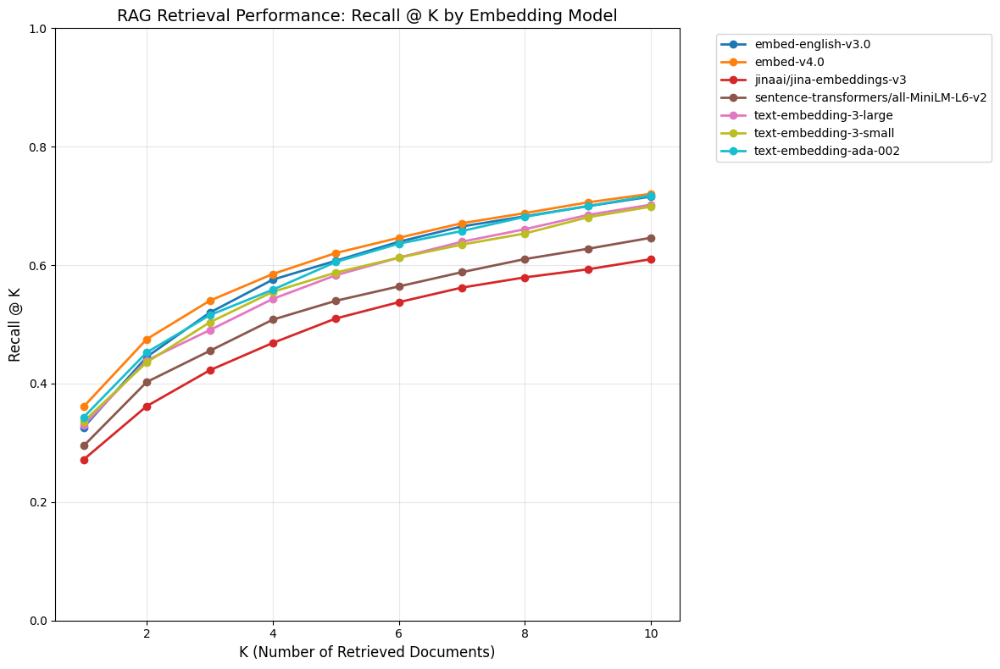

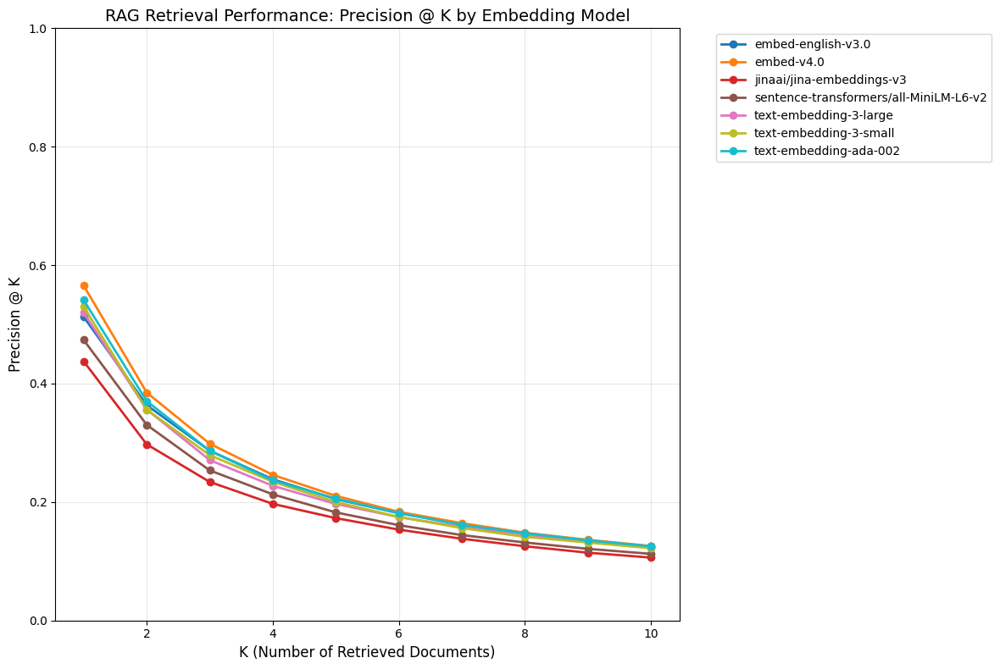

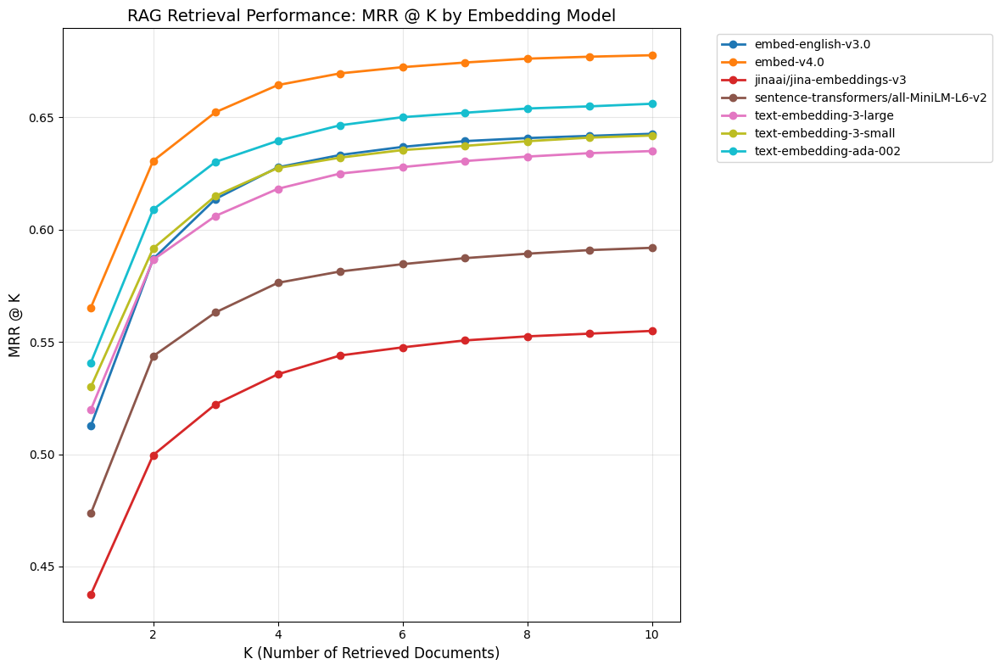


Summary table of metrics by embedding model:
Recall@K:
k                                           1       2       3       4   \
embedding_model                                                          
embed-english-v3.0                      0.3262  0.4450  0.5198  0.5755   
embed-v4.0                              0.3612  0.4750  0.5399  0.5850   
jinaai/jina-embeddings-v3               0.2718  0.3619  0.4225  0.4687   
sentence-transformers/all-MiniLM-L6-v2  0.2950  0.4027  0.4552  0.5080   
text-embedding-3-large                  0.3299  0.4391  0.4903  0.5430   
text-embedding-3-small                  0.3360  0.4359  0.5035  0.5549   
text-embedding-ada-002                  0.3433  0.4527  0.5155  0.5585   

k                                           5       6       7       8   \
embedding_model                                                          
embed-english-v3.0                      0.6074  0.6395  0.6653  0.6825   
embed-v4.0                              0.6204  0.6462 

In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def calculate_metrics_at_k(results_df, max_k=10):
    """
    Calculate Recall@K, Precision@K, and MRR@K for each query at different K values
    """
    metrics_results = []
    
    for query in results_df['query'].unique():
        for embedding_model in embedding_models:
            query_data = results_df[(results_df['query'] == query) & (results_df['embedding_model'] == embedding_model)].copy()
            query_data = query_data.sort_values('document_rank')
            
            # For each K value
            for k in range(1, max_k + 1):
                # Consider only top-k documents
                top_k_docs = query_data[query_data['document_rank'] < k]
                
                if len(top_k_docs) == 0:
                    # No documents at this K
                    recall_at_k = 0.0
                    precision_at_k = 0.0
                    mrr_at_k = 0.0
                else:
                    # Recall@K
                    relevant_retrieved = top_k_docs['evidence_match'].sum()
                    total_relevant = evidence_counts[query]
                    recall_at_k = relevant_retrieved / total_relevant if total_relevant > 0 else 0.0
                    
                    # Precision@K  
                    total_retrieved = len(top_k_docs)
                    precision_at_k = relevant_retrieved / total_retrieved if total_retrieved > 0 else 0.0
                    
                    # MRR@K (reciprocal rank of first relevant doc within top-K)
                    relevant_docs = top_k_docs[top_k_docs['evidence_match'] == True]
                    if len(relevant_docs) > 0:
                        first_relevant_rank = relevant_docs['document_rank'].min() + 1  # Convert to 1-indexed
                        mrr_at_k = 1.0 / first_relevant_rank
                    else:
                        mrr_at_k = 0.0
                
                metrics_results.append({
                    'query': query,
                    'embedding_model': embedding_model,
                    'k': k,
                    'recall_at_k': recall_at_k,
                    'precision_at_k': precision_at_k,
                    'mrr_at_k': mrr_at_k
                })
        
    return pd.DataFrame(metrics_results)

def aggregate_metrics_by_model_and_k(metrics_df):
    """
    Aggregate metrics by embedding model and K value
    """
    aggregated = metrics_df.groupby(['embedding_model', 'k']).agg({
        'recall_at_k': 'mean',
        'precision_at_k': 'mean', 
        'mrr_at_k': 'mean'
    }).reset_index()
    
    return aggregated

def plot_metrics_at_k(aggregated_df, metric='recall_at_k', title_suffix='Recall'):
    """
    Create a plot similar to your example showing metric@K performance
    """
    plt.figure(figsize=(12, 8))
    
    # Get unique embedding models
    models = aggregated_df['embedding_model'].unique()
    
    # Create color palette
    colors = plt.cm.tab10(np.linspace(0, 1, len(models)))
    
    for i, model in enumerate(models):
        model_data = aggregated_df[aggregated_df['embedding_model'] == model]
        plt.plot(model_data['k'], model_data[metric], 
                marker='o', linewidth=2, markersize=6, 
                label=model, color=colors[i])
    
    plt.xlabel('K (Number of Retrieved Documents)', fontsize=12)
    plt.ylabel(f'{title_suffix} @ K', fontsize=12)
    plt.title(f'RAG Retrieval Performance: {title_suffix} @ K by Embedding Model', fontsize=14)
    plt.grid(True, alpha=0.3)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    
    # Set y-axis limits
    if metric in ['recall_at_k', 'precision_at_k']:
        plt.ylim(0, 1.0)
    
    plt.show()

# Calculate metrics at different K values
print("Calculating metrics at different K values...")
metrics_df = calculate_metrics_at_k(results_df, max_k=10)

# Aggregate by model and K
aggregated_metrics = aggregate_metrics_by_model_and_k(metrics_df)

# Display sample results
print("\nSample of calculated metrics:")
print(aggregated_metrics.head(20))

# Create plots for each metric
print("\nCreating plots...")

# Plot 1: Recall@K
plot_metrics_at_k(aggregated_metrics, 'recall_at_k', 'Recall')

# Plot 2: Precision@K  
plot_metrics_at_k(aggregated_metrics, 'precision_at_k', 'Precision')

# Plot 3: MRR@K
plot_metrics_at_k(aggregated_metrics, 'mrr_at_k', 'MRR')

# Summary table
print("\nSummary table of metrics by embedding model:")
summary_table = aggregated_metrics.pivot_table(
    index='embedding_model', 
    columns='k', 
    values=['recall_at_k', 'precision_at_k', 'mrr_at_k'],
    aggfunc='mean'
).round(4)

print("Recall@K:")
print(summary_table['recall_at_k'])
print("\nPrecision@K:")  
print(summary_table['precision_at_k'])
print("\nMRR@K:")
print(summary_table['mrr_at_k'])

In [41]:
metrics_df

,query,embedding_model,k,recall_at_k,precision_at_k,mrr_at_k
0,Who are the female account holders who own cre...,text-embedding-3-small,1,0.0,0.000000,0.000000
1,Who are the female account holders who own cre...,text-embedding-3-small,2,0.0,0.000000,0.000000
2,Who are the female account holders who own cre...,text-embedding-3-small,3,0.0,0.000000,0.000000
3,Who are the female account holders who own cre...,text-embedding-3-small,4,0.0,0.000000,0.000000
4,Who are the female account holders who own cre...,text-embedding-3-small,5,0.0,0.000000,0.000000
...,...,...,...,...,...,...
96945,How many artists have designed a card with a b...,jinaai/jina-embeddings-v3,6,0.0,0.000000,0.000000
96946,How many artists have designed a card with a b...,jinaai/jina-embeddings-v3,7,1.0,0.142857,0.142857
96947,How many artists have designed a card with a b...,jinaai/jina-embeddings-v3,8,1.0,0.125000,0.142857
96948,How many artists have designed a card with a b...,jinaai/jina-embeddings-v3,9,1.0,0.111111,0.142857


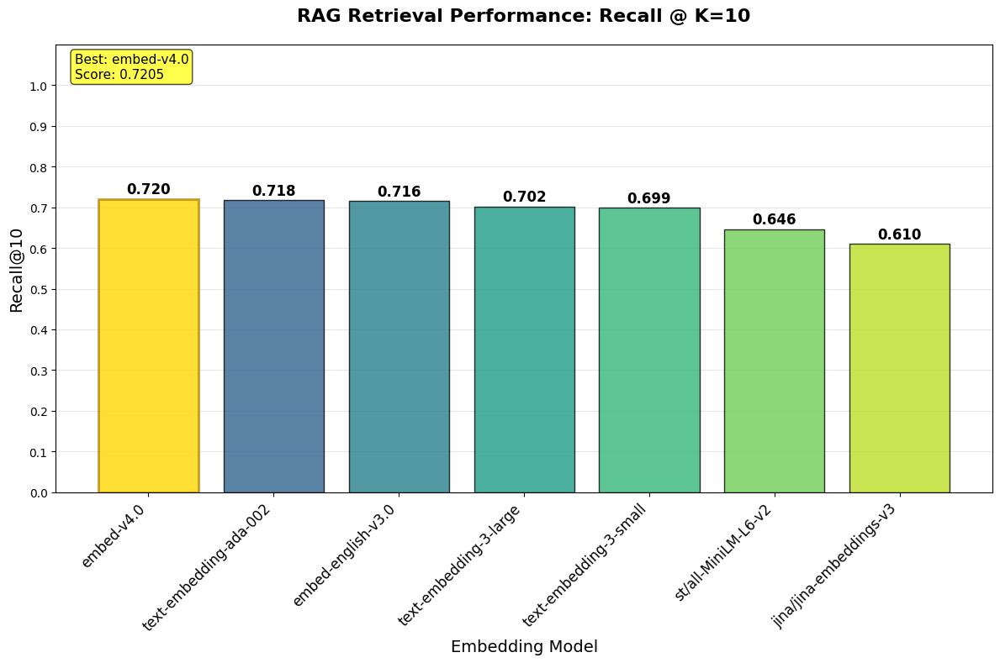

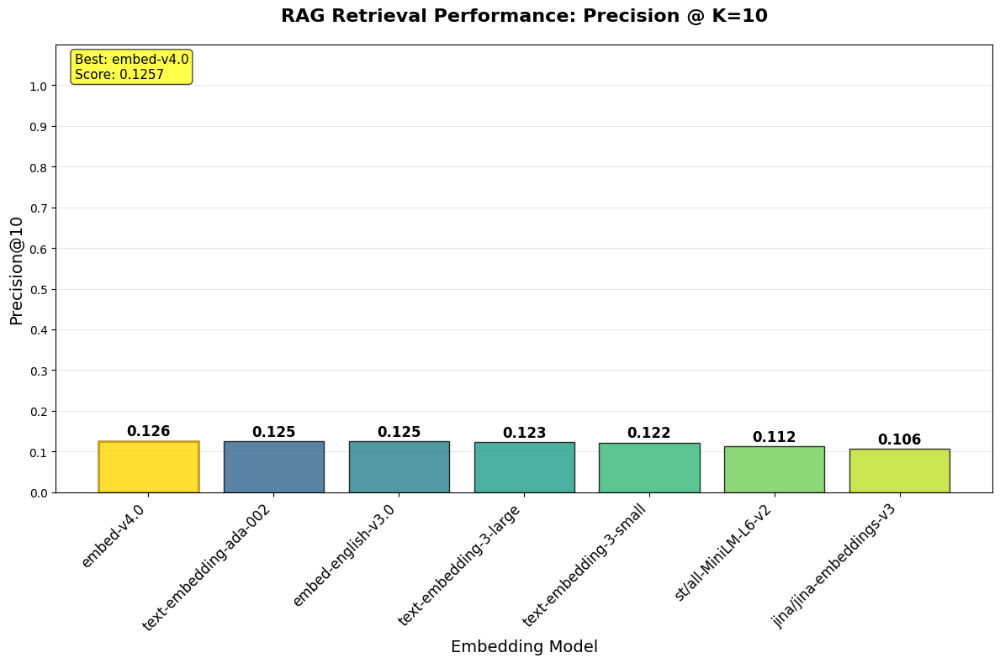

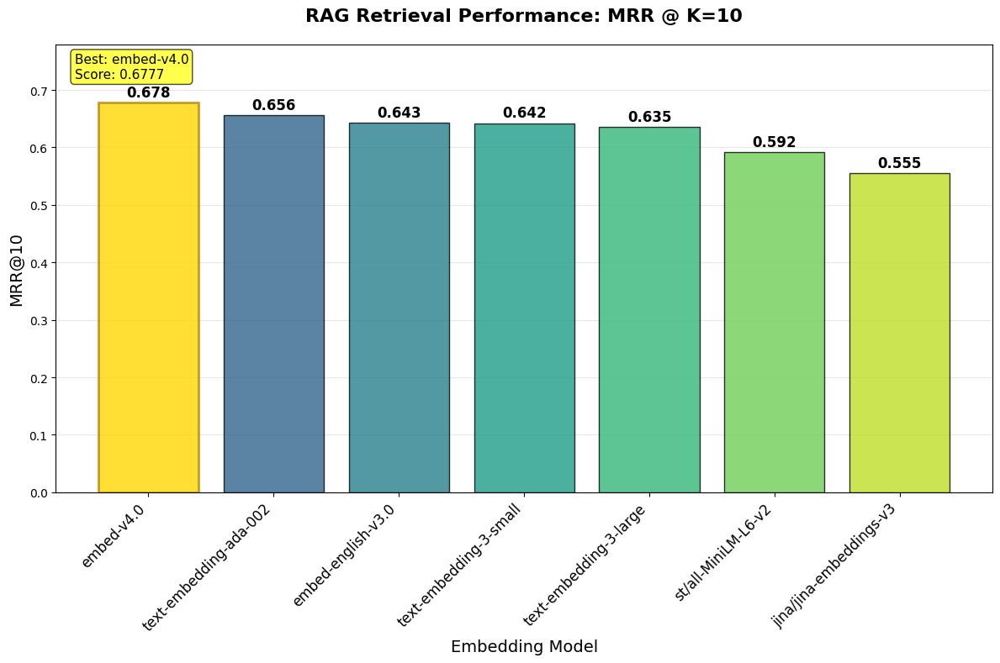

In [45]:
def create_individual_k10_charts(aggregated_metrics):
    """
    Create 3 separate, larger bar charts for better visibility
    """
    # Filter data for k=10
    k10_data = aggregated_metrics[aggregated_metrics['k'] == 10].copy()
    k10_data = k10_data.sort_values('recall_at_k', ascending=False)
    
    metrics = [
        ('recall_at_k', 'Recall @ K=10', 'Recall@10'),
        ('precision_at_k', 'Precision @ K=10', 'Precision@10'),
        ('mrr_at_k', 'MRR @ K=10', 'MRR@10')
    ]
    
    for metric_col, title, ylabel in metrics:
        plt.figure(figsize=(12, 8))
        
        # Sort data by current metric for this chart
        chart_data = k10_data.sort_values(metric_col, ascending=False)
        
        # Create color gradient based on performance
        colors = plt.cm.viridis(np.linspace(0.2, 0.9, len(chart_data)))
        
        # Create bar chart
        bars = plt.bar(range(len(chart_data)), chart_data[metric_col], 
                      color=colors, alpha=0.8, edgecolor='black', linewidth=1)
        
        # Highlight the best performer
        bars[0].set_color('gold')
        bars[0].set_edgecolor('darkgoldenrod')
        bars[0].set_linewidth(2)
        
        # Customize the chart
        plt.title(f'RAG Retrieval Performance: {title}', fontsize=16, fontweight='bold', pad=20)
        plt.ylabel(ylabel, fontsize=14)
        plt.xlabel('Embedding Model', fontsize=14)
        
        # Set x-axis labels
        model_names = [name.replace('sentence-transformers/', 'st/').replace('jinaai/', 'jina/') 
                      for name in chart_data['embedding_model']]
        plt.xticks(range(len(chart_data)), model_names, rotation=45, ha='right', fontsize=12)
        
        # Add value labels on bars
        for i, (bar, value) in enumerate(zip(bars, chart_data[metric_col])):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + 0.005,
                    f'{value:.3f}', ha='center', va='bottom', fontsize=12, fontweight='bold')
        
        # Set y-axis limits and formatting
        if metric_col in ['recall_at_k', 'precision_at_k']:
            plt.ylim(0, 1.1)
            plt.yticks(np.arange(0, 1.1, 0.1))
        else:  # MRR
            max_val = chart_data[metric_col].max()
            plt.ylim(0, max_val * 1.15)
        
        # Add grid and styling
        plt.grid(True, alpha=0.3, axis='y')
        plt.gca().set_axisbelow(True)
        
        # Add performance annotation
        best_model = chart_data.iloc[0]['embedding_model']
        best_score = chart_data.iloc[0][metric_col]
        plt.text(0.02, 0.98, f'Best: {best_model}\nScore: {best_score:.4f}', 
                transform=plt.gca().transAxes, fontsize=11, 
                verticalalignment='top', bbox=dict(boxstyle="round,pad=0.3", facecolor="yellow", alpha=0.7))
        
        plt.tight_layout()
        plt.show()

# Create individual charts
create_individual_k10_charts(aggregated_metrics)

Starting domain-specific analysis...
Calculating Recall@10 by database...
Total data points for k=10: 96950
Unique databases: ['financial' 'student_club' 'thrombosis_prediction'
 'debit_card_specializing' 'card_games' 'codebase_community' 'toxicology'
 'california_schools' 'formula_1' 'superhero' 'european_football_2']
Unique embedding models: ['text-embedding-3-small' 'text-embedding-3-large'
 'text-embedding-ada-002' 'embed-english-v3.0' 'embed-v4.0'
 'sentence-transformers/all-MiniLM-L6-v2' 'jinaai/jina-embeddings-v3']


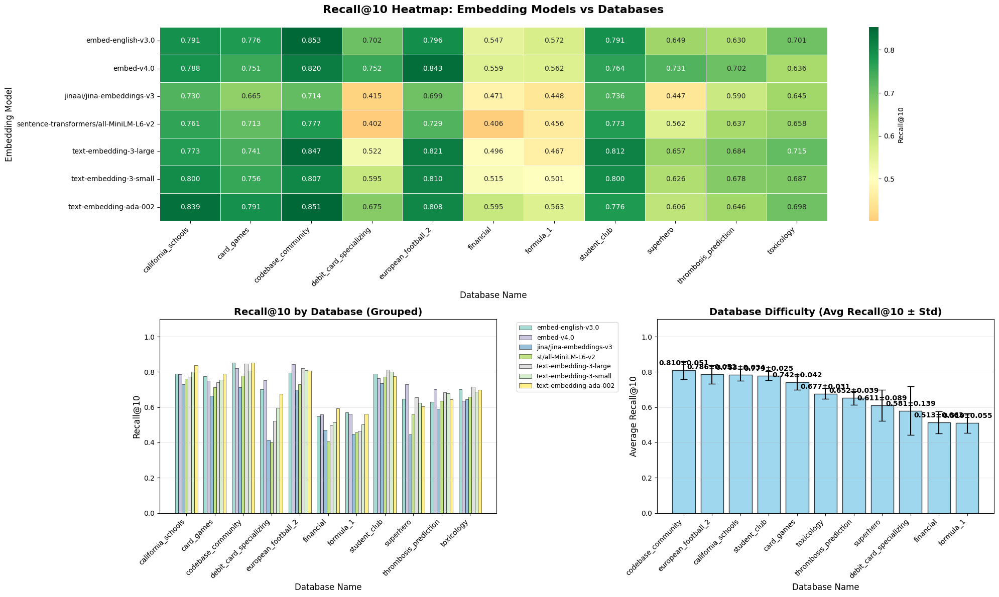


DOMAIN-SPECIFIC PERFORMANCE ANALYSIS

🏆 BEST EMBEDDING MODEL PER DATABASE:
------------------------------------------------------------
california_schools   | text-embedding-ada-002              | 0.8394
card_games           | text-embedding-ada-002              | 0.7913
codebase_community   | embed-english-v3.0                  | 0.8533
debit_card_specializing | embed-v4.0                          | 0.7520
european_football_2  | embed-v4.0                          | 0.8426
financial            | text-embedding-ada-002              | 0.5948
formula_1            | embed-english-v3.0                  | 0.5715
student_club         | text-embedding-3-large              | 0.8122
superhero            | embed-v4.0                          | 0.7313
thrombosis_prediction | embed-v4.0                          | 0.7023
toxicology           | text-embedding-3-large              | 0.7154

📊 MODEL CONSISTENCY ACROSS DATABASES:
------------------------------------------------------------
Model      

In [60]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

def calculate_recall_at_10_by_db(results_df):
    """
    Calculate Recall@10 for each embedding model broken down by database
    """
    # Filter for k=10 (documents ranked 0-9)
    k10_data = results_df[results_df['document_rank'] < 10].copy()
    
    print("Calculating Recall@10 by database...")
    print(f"Total data points for k=10: {len(k10_data)}")
    print(f"Unique databases: {k10_data['db_name'].unique()}")
    print(f"Unique embedding models: {k10_data['embedding_model'].unique()}")
    
    # Calculate recall@10 for each combination of embedding_model, db_name, and query
    recall_results = []
    
    for db_name in k10_data['db_name'].unique():
        db_data = k10_data[k10_data['db_name'] == db_name]
        
        for embedding_model in db_data['embedding_model'].unique():
            model_db_data = db_data[db_data['embedding_model'] == embedding_model]
            
            for query in model_db_data['query'].unique():
                query_data = model_db_data[model_db_data['query'] == query]
                
                # Calculate recall for this query
                relevant_retrieved = query_data['evidence_match'].sum()
                total_relevant = evidence_counts[query]
                recall_at_10 = relevant_retrieved / total_relevant if total_relevant > 0 else 0.0
                
                recall_results.append({
                    'db_name': db_name,
                    'embedding_model': embedding_model,
                    'query': query,
                    'recall_at_10': recall_at_10
                })
    
    # Convert to DataFrame and aggregate by db_name and embedding_model
    recall_df = pd.DataFrame(recall_results)
    
    # Calculate mean recall@10 for each db_name + embedding_model combination
    aggregated_recall = recall_df.groupby(['db_name', 'embedding_model'])['recall_at_10'].mean().reset_index()
    
    return aggregated_recall, recall_df

def create_recall_by_db_visualization(aggregated_recall):
    """
    Create visualizations showing Recall@10 by database and embedding model
    """
    # Create pivot table for heatmap
    pivot_data = aggregated_recall.pivot(index='embedding_model', columns='db_name', values='recall_at_10')
    
    # Create figure with subplots
    fig = plt.figure(figsize=(20, 12))
    
    # 1. Heatmap
    plt.subplot(2, 2, (1, 2))  # Top row, spans 2 columns
    sns.heatmap(pivot_data, annot=True, cmap='RdYlGn', center=0.5, 
                fmt='.3f', cbar_kws={'label': 'Recall@10'}, 
                linewidths=0.5, square=False)
    plt.title('Recall@10 Heatmap: Embedding Models vs Databases', fontsize=16, fontweight='bold', pad=20)
    plt.xlabel('Database Name', fontsize=12)
    plt.ylabel('Embedding Model', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    
    # 2. Grouped bar chart
    plt.subplot(2, 2, 3)
    
    # Prepare data for grouped bar chart
    db_names = aggregated_recall['db_name'].unique()
    model_names = aggregated_recall['embedding_model'].unique()
    
    x = np.arange(len(db_names))
    width = 0.8 / len(model_names)
    
    colors = plt.cm.Set3(np.linspace(0, 1, len(model_names)))
    
    for i, model in enumerate(model_names):
        model_data = aggregated_recall[aggregated_recall['embedding_model'] == model]
        values = [model_data[model_data['db_name'] == db]['recall_at_10'].iloc[0] 
                 if len(model_data[model_data['db_name'] == db]) > 0 else 0 
                 for db in db_names]
        
        plt.bar(x + i * width, values, width, label=model.replace('sentence-transformers/', 'st/').replace('jinaai/', 'jina/'), 
                color=colors[i], alpha=0.8, edgecolor='black', linewidth=0.5)
    
    plt.xlabel('Database Name', fontsize=12)
    plt.ylabel('Recall@10', fontsize=12)
    plt.title('Recall@10 by Database (Grouped)', fontsize=14, fontweight='bold')
    plt.xticks(x + width * (len(model_names) - 1) / 2, db_names, rotation=45, ha='right')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=9)
    plt.grid(True, alpha=0.3, axis='y')
    plt.ylim(0, 1.1)
    
    # 3. Performance by database (average across models)
    plt.subplot(2, 2, 4)
    
    db_performance = aggregated_recall.groupby('db_name')['recall_at_10'].agg(['mean', 'std']).reset_index()
    db_performance = db_performance.sort_values('mean', ascending=False)
    
    bars = plt.bar(range(len(db_performance)), db_performance['mean'], 
                   color='skyblue', alpha=0.8, edgecolor='black', linewidth=1)
    plt.errorbar(range(len(db_performance)), db_performance['mean'], 
                 yerr=db_performance['std'], fmt='none', color='black', capsize=5)
    
    # Add value labels
    for i, (bar, mean_val, std_val) in enumerate(zip(bars, db_performance['mean'], db_performance['std'])):
        plt.text(bar.get_x() + bar.get_width()/2., bar.get_height() + 0.02,
                f'{mean_val:.3f}±{std_val:.3f}', ha='center', va='bottom', fontsize=10, fontweight='bold')
    
    plt.xlabel('Database Name', fontsize=12)
    plt.ylabel('Average Recall@10', fontsize=12)
    plt.title('Database Difficulty (Avg Recall@10 ± Std)', fontsize=14, fontweight='bold')
    plt.xticks(range(len(db_performance)), db_performance['db_name'], rotation=45, ha='right')
    plt.grid(True, alpha=0.3, axis='y')
    plt.ylim(0, 1.1)
    
    plt.tight_layout()
    plt.show()

def analyze_domain_performance(aggregated_recall):
    """
    Analyze and print insights about domain-specific performance
    """
    print("\n" + "="*100)
    print("DOMAIN-SPECIFIC PERFORMANCE ANALYSIS")
    print("="*100)
    
    # Best model per database
    print("\n🏆 BEST EMBEDDING MODEL PER DATABASE:")
    print("-" * 60)
    
    for db in aggregated_recall['db_name'].unique():
        db_data = aggregated_recall[aggregated_recall['db_name'] == db]
        best_model = db_data.loc[db_data['recall_at_10'].idxmax()]
        print(f"{db:<20} | {best_model['embedding_model']:<35} | {best_model['recall_at_10']:.4f}")
    
    # Most consistent model across databases
    print(f"\n📊 MODEL CONSISTENCY ACROSS DATABASES:")
    print("-" * 60)
    
    model_consistency = aggregated_recall.groupby('embedding_model')['recall_at_10'].agg(['mean', 'std']).round(4)
    model_consistency['consistency_score'] = model_consistency['mean'] - model_consistency['std']  # Higher is better
    model_consistency = model_consistency.sort_values('consistency_score', ascending=False)
    
    print(f"{'Model':<35} | {'Avg Recall@10':<12} | {'Std Dev':<10} | {'Consistency Score':<15}")
    print("-" * 80)
    for model, row in model_consistency.iterrows():
        print(f"{model:<35} | {row['mean']:<12.4f} | {row['std']:<10.4f} | {row['consistency_score']:<15.4f}")
    
    # Database difficulty ranking
    print(f"\n🎯 DATABASE DIFFICULTY RANKING (Easier = Higher Avg Recall@10):")
    print("-" * 60)
    
    db_difficulty = aggregated_recall.groupby('db_name')['recall_at_10'].agg(['mean', 'std', 'count']).round(4)
    db_difficulty = db_difficulty.sort_values('mean', ascending=False)
    
    print(f"{'Database':<20} | {'Avg Recall@10':<12} | {'Std Dev':<10} | {'# Models':<10}")
    print("-" * 60)
    for db, row in db_difficulty.iterrows():
        difficulty_level = "Easy" if row['mean'] > 0.7 else "Medium" if row['mean'] > 0.4 else "Hard"
        print(f"{db:<20} | {row['mean']:<12.4f} | {row['std']:<10.4f} | {row['count']:<10.0f} | ({difficulty_level})")
    
    return model_consistency, db_difficulty

# Execute the analysis
print("Starting domain-specific analysis...")

# Calculate recall@10 by database
aggregated_recall, detailed_recall = calculate_recall_at_10_by_db(results_df)

# Create visualizations
create_recall_by_db_visualization(aggregated_recall)

# Analyze performance patterns
model_consistency, db_difficulty = analyze_domain_performance(aggregated_recall)

# Additional insight: correlation between model performance across databases
print(f"\n🔗 MODEL PERFORMANCE CORRELATION ACROSS DATABASES:")
print("-" * 60)

correlation_matrix = aggregated_recall.pivot(index='db_name', columns='embedding_model', values='recall_at_10').corr()
print("Top 3 most correlated model pairs:")
corr_pairs = []
for i in range(len(correlation_matrix.columns)):
    for j in range(i+1, len(correlation_matrix.columns)):
        model1 = correlation_matrix.columns[i]
        model2 = correlation_matrix.columns[j]
        corr = correlation_matrix.iloc[i, j]
        corr_pairs.append((model1, model2, corr))

corr_pairs.sort(key=lambda x: x[2], reverse=True)
for model1, model2, corr in corr_pairs[:3]:
    print(f"  {model1} ↔ {model2}: {corr:.3f}")